In [18]:
import urllib.request
from bs4 import BeautifulSoup
import pandas as pd
import folium
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt


In [5]:
url = 'https://en.wikipedia.org/wiki/List_of_London_boroughs'
page = urllib.request.urlopen(url)
soup = BeautifulSoup(page, "html5lib")
borough_table_soup=soup.find_all('table', class_='wikitable sortable')


In [6]:
A=[]
B=[]
C=[]
D=[]
E=[]
F=[]
G=[]
H=[]
I=[]
J=[]

for row in borough_table_soup[0].findAll('tr'):
    cells=row.findAll('td')
    if len(cells)==10:
        A.append(cells[0].find(text=True))
        B.append(cells[1].find(text=True))
        C.append(cells[2].find(text=True))
        D.append(cells[3].find(text=True))
        E.append(cells[4].find(text=True))
        F.append(cells[5].find(text=True))
        G.append(cells[6].find(text=True))
        H.append(cells[7].find(text=True))
        I.append(cells[8].find(text=True))
        J.append(cells[9].find(text=True))

borough_table=pd.DataFrame(A,columns=['Borough'])
borough_table['Inner']=B
borough_table['Status']=C
borough_table['Local authority']=D
borough_table['Political control']=E
borough_table['Headquarters']=F
borough_table['Area (sq mi)']=G
borough_table['Population (2019 est)']=H
borough_table['Co-ordinates']=I
borough_table['Nr. in map']=J



In [7]:
borough_table.drop(['Inner', 'Status', 'Co-ordinates','Nr. in map',  'Headquarters'], axis=1, inplace=True)
borough_table['Area (sq mi)'] = borough_table['Area (sq mi)'].str.replace(r'\n', '')
borough_table['Population (2019 est)'] = borough_table['Population (2019 est)'].str.replace(r'\n', '')

<ipython-input-7-5c16d2f9567c>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  borough_table['Area (sq mi)'] = borough_table['Area (sq mi)'].str.replace(r'\n', '')
<ipython-input-7-5c16d2f9567c>:3: FutureWarning: The default value of regex will change from True to False in a future version.
  borough_table['Population (2019 est)'] = borough_table['Population (2019 est)'].str.replace(r'\n', '')


### If reproducing this analysis, road collision data is available from https://tfl.gov.uk/corporate/publications-and-reports/road-safety
### Although please note that this data doesn't include latitude and longitude data by default, to convert this I used the Ordanance Surveys OSTN15 OSGM15 Transformation Software, available here: https://www.ordnancesurvey.co.uk/business-government/tools-support/os-net/transformation

In [8]:
COL = {'Borough':'City of London', 'Local authority':'Corporation of London', 'Political control':'N/A', 'Area (sq mi)':'1.12', 'Population (2019 est)':'9721'}
borough_table = borough_table.append(COL, ignore_index=True)
borough_coordinates = pd.read_csv('London Boroughs.csv')
borough_table = pd.merge(borough_table, borough_coordinates, on='Borough', how='inner')
borough_table

,Borough,Local authority,Political control,Area (sq mi),Population (2019 est),Latitude,Longitude
0,Barking and Dagenham,Barking and Dagenham London Borough Council,Labour,13.93,"212,906",51.5607,0.1557
1,Barnet,Barnet London Borough Council,Conservative,33.49,"395,896",51.6252,-0.1517
2,Bexley,Bexley London Borough Council,Conservative,23.38,"248,287",51.4549,0.1505
3,Brent,Brent London Borough Council,Labour,16.70,"329,771",51.5588,-0.2817
4,Bromley,Bromley London Borough Council,Conservative,57.97,"332,336",51.4039,0.0198
5,Camden,Camden London Borough Council,Labour,8.40,"270,029",51.5290,-0.1255
6,Croydon,Croydon London Borough Council,Labour,33.41,"386,710",51.3714,-0.0977
7,Ealing,Ealing London Borough Council,Labour,21.44,"341,806",51.5130,-0.3089
8,Enfield,Enfield London Borough Council,Labour,31.74,"333,794",51.6538,-0.0799
9,Greenwich,Greenwich London Borough Council,Labour,18.28,"287,942",51.4892,0.0648


In [9]:
gla_vd = 'TFL Accident Data\jan-jun-2020-gla-data-extract-vehicle.csv'

accident_data = pd.read_csv(gla_vd, skiprows=1)
accident_data.drop(['Easting', 'Northing', 'Vehicle ref', 'Vehicle Type (Banded)', 'Journey Purpose', 'Veh. Impact', 'Veh. Off C/W', 'Veh Leave C/W', 'Object in C/W', 'Restricted Lane', 'Junction Location', 'Vehicle Skidding'], axis=1, inplace=True)
accident_data['Driver Age'].fillna(value=accident_data['Driver Age'].mean(), inplace=True)
accident_data['Driver Age (Banded)'] = accident_data['Driver Age (Banded)'].str.replace(r'Unknown', '35-64')
borough_table['Borough'] = borough_table['Borough'].str.replace(r'&', 'and')
borough_table['Borough'] = borough_table['Borough'].str.replace(r'Of', 'of')
accident_data



,AREFNO,Borough,Boro,Latitude,Longitude,Vehicle Type,Vehicle Manoeuvres,Driver Sex,Driver Age,Driver Age (Banded)
0,1200219808,Wandsworth,10,51.462262,-0.254001,09 Car,05 Moving Off,2 Female,32.000000,25-34
1,1200220496,Lambeth,9,51.470327,-0.139253,09 Car,04 Slowing Or Stopping,1 Male,45.000000,35-64
2,1200228005,Westminster,1,51.529614,-0.178719,09 Car,18 Going Ahead Other,3 Not Traced,38.294183,35-64
3,1200228006,Newham,17,51.541210,-0.001683,06 Private Hire - Licensed,18 Going Ahead Other,1 Male,44.000000,35-64
4,1200228011,Westminster,1,51.515704,-0.137592,09 Car,18 Going Ahead Other,1 Male,20.000000,17-24
...,...,...,...,...,...,...,...,...,...,...
16328,48200958805,City of London,0,51.517500,-0.095978,09 Car,16 Going Ahead Left Bend,1 Male,37.000000,35-64
16329,48200958816,City of London,0,51.511587,-0.075299,08 Taxi,18 Going Ahead Other,1 Male,28.000000,25-34
16330,48200958816,City of London,0,51.511587,-0.075299,05 M/C > 500Cc,18 Going Ahead Other,1 Male,55.000000,35-64
16331,48200962956,Hackney,4,51.520162,-0.082721,01 Pedal Cycle,18 Going Ahead Other,1 Male,34.000000,25-34


In [10]:
london_vehicle_accident_map = folium.Map(location=[51.509865, -0.118092], zoom_start=12)

# add markers to map
for Latitude, Longitude, Borough in zip(accident_data['Latitude'], accident_data['Longitude'], accident_data['Borough']):
    label = '{}'.format(Borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [Latitude, Longitude],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(london_vehicle_accident_map)  
    
london_vehicle_accident_map

In [11]:
accident_onehot = pd.get_dummies(accident_data[['Vehicle Type']], prefix="", prefix_sep="")
accident_onehot['Borough'] = accident_data['Borough'] 
fixed_columns = [accident_onehot.columns[-1]] + list(accident_onehot.columns[:-1])
accident_onehot = accident_onehot[fixed_columns]
accident_grouped = accident_onehot.groupby('Borough').mean().reset_index()
accident_grouped

,Borough,01 Pedal Cycle,02 M/C <= 50Cc,03 M/C 50-125Cc,04 M/C 125-500Cc,05 M/C > 500Cc,06 Private Hire - Licensed,08 Taxi,09 Car,10 Minibus,...,18 Tram,19 Gds =< 3.5T,20 Gds 3.5-7.5T,21 Gds => 7.5T,22 Mobility Scooter,23 M/C Electric,90 Other Vehicle,97 M/C Unknown Cc (S/R),98 Goods Unknown Kg (S/R),99 Unknown (S/R)
0,Barking and Dagenham,0.044855,0.002639,0.034301,0.005277,0.010554,0.007916,0.021108,0.730871,0.000000,...,0.00000,0.063325,0.002639,0.010554,0.000000,0.000000,0.029024,0.000000,0.002639,0.000000
1,Barnet,0.050794,0.007937,0.079365,0.011111,0.026984,0.012698,0.012698,0.679365,0.007937,...,0.00000,0.055556,0.001587,0.006349,0.000000,0.001587,0.019048,0.006349,0.006349,0.000000
2,Bexley,0.043344,0.003096,0.043344,0.003096,0.015480,0.012384,0.006192,0.743034,0.006192,...,0.00000,0.061920,0.003096,0.009288,0.000000,0.000000,0.018576,0.003096,0.003096,0.000000
3,Brent,0.066558,0.017857,0.139610,0.011364,0.012987,0.009740,0.012987,0.623377,0.001623,...,0.00000,0.051948,0.003247,0.003247,0.000000,0.000000,0.012987,0.000000,0.008117,0.000000
4,Bromley,0.112172,0.014320,0.047733,0.011933,0.014320,0.009547,0.000000,0.696897,0.000000,...,0.00000,0.057279,0.000000,0.004773,0.000000,0.000000,0.007160,0.000000,0.000000,0.000000
5,Camden,0.183794,0.011858,0.118577,0.027668,0.025692,0.015810,0.043478,0.416996,0.003953,...,0.00000,0.073123,0.003953,0.001976,0.000000,0.000000,0.023715,0.000000,0.003953,0.000000
6,City of London,0.227273,0.000000,0.068182,0.022727,0.056818,0.000000,0.170455,0.272727,0.000000,...,0.00000,0.102273,0.011364,0.000000,0.000000,0.000000,0.011364,0.000000,0.000000,0.000000
7,Croydon,0.072948,0.010638,0.082067,0.007599,0.010638,0.003040,0.024316,0.677812,0.001520,...,0.00000,0.051672,0.001520,0.003040,0.000000,0.000000,0.025836,0.003040,0.000000,0.000000
8,Ealing,0.073463,0.022489,0.085457,0.008996,0.016492,0.007496,0.013493,0.664168,0.001499,...,0.00000,0.059970,0.000000,0.004498,0.000000,0.000000,0.010495,0.000000,0.004498,0.000000
9,Enfield,0.059006,0.009317,0.051242,0.007764,0.009317,0.009317,0.010870,0.717391,0.001553,...,0.00000,0.059006,0.009317,0.009317,0.000000,0.000000,0.015528,0.001553,0.003106,0.000000


In [12]:
vehicle_types = 5

for borough in accident_grouped['Borough']:
    print("----"+borough+"----")
    temp = accident_grouped[accident_grouped['Borough'] == borough].T.reset_index()
    temp.columns = ['Veh Type','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(vehicle_types))
    print('\n')

----Barking and Dagenham----
          Veh Type  freq
0           09 Car  0.73
1   19 Gds =< 3.5T  0.06
2   01 Pedal Cycle  0.04
3  03 M/C 50-125Cc  0.03
4    13 London Bus  0.03


----Barnet----
          Veh Type  freq
0           09 Car  0.68
1  03 M/C 50-125Cc  0.08
2   19 Gds =< 3.5T  0.06
3   01 Pedal Cycle  0.05
4   05 M/C > 500Cc  0.03


----Bexley----
          Veh Type  freq
0           09 Car  0.74
1   19 Gds =< 3.5T  0.06
2   01 Pedal Cycle  0.04
3  03 M/C 50-125Cc  0.04
4   05 M/C > 500Cc  0.02


----Brent----
          Veh Type  freq
0           09 Car  0.62
1  03 M/C 50-125Cc  0.14
2   01 Pedal Cycle  0.07
3   19 Gds =< 3.5T  0.05
4    13 London Bus  0.02


----Bromley----
          Veh Type  freq
0           09 Car  0.70
1   01 Pedal Cycle  0.11
2   19 Gds =< 3.5T  0.06
3  03 M/C 50-125Cc  0.05
4    13 London Bus  0.02


----Camden----
          Veh Type  freq
0           09 Car  0.42
1   01 Pedal Cycle  0.18
2  03 M/C 50-125Cc  0.12
3   19 Gds =< 3.5T  0.07
4          

In [13]:
def return_most_accident_prone_vehicle (row, vehicle_types):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:vehicle_types]

In [14]:
num_veh_types = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Borough']
for ind in np.arange(num_veh_types):
    try:
        columns.append('{}{} Most Common Vehicle Type'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Vehicle Type'.format(ind+1))

# create a new dataframe
borough_accident_vehicles_sorted = pd.DataFrame(columns=columns)
borough_accident_vehicles_sorted['Borough'] = accident_grouped['Borough']

for ind in np.arange(accident_grouped.shape[0]):
    borough_accident_vehicles_sorted.iloc[ind, 1:] = return_most_accident_prone_vehicle(accident_grouped.iloc[ind, :], num_veh_types)

borough_accident_vehicles_sorted.head()

,Borough,1st Most Common Vehicle Type,2nd Most Common Vehicle Type,3rd Most Common Vehicle Type,4th Most Common Vehicle Type,5th Most Common Vehicle Type,6th Most Common Vehicle Type,7th Most Common Vehicle Type,8th Most Common Vehicle Type,9th Most Common Vehicle Type,10th Most Common Vehicle Type
0,Barking and Dagenham,09 Car,19 Gds =< 3.5T,01 Pedal Cycle,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,08 Taxi,05 M/C > 500Cc,21 Gds => 7.5T,06 Private Hire - Licensed
1,Barnet,09 Car,03 M/C 50-125Cc,19 Gds =< 3.5T,01 Pedal Cycle,05 M/C > 500Cc,90 Other Vehicle,13 London Bus,08 Taxi,06 Private Hire - Licensed,04 M/C 125-500Cc
2,Bexley,09 Car,19 Gds =< 3.5T,01 Pedal Cycle,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,05 M/C > 500Cc,06 Private Hire - Licensed,21 Gds => 7.5T,08 Taxi
3,Brent,09 Car,03 M/C 50-125Cc,01 Pedal Cycle,19 Gds =< 3.5T,13 London Bus,02 M/C <= 50Cc,05 M/C > 500Cc,08 Taxi,90 Other Vehicle,04 M/C 125-500Cc
4,Bromley,09 Car,01 Pedal Cycle,19 Gds =< 3.5T,03 M/C 50-125Cc,13 London Bus,05 M/C > 500Cc,02 M/C <= 50Cc,04 M/C 125-500Cc,06 Private Hire - Licensed,90 Other Vehicle


Initialization complete
Iteration 0, inertia 0.9109327186603093.
Iteration 1, inertia 0.6743409925632136.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 1.6950156401120646.
Iteration 1, inertia 0.6743409925632136.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 0.9109327186603093.
Iteration 1, inertia 0.6743409925632136.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 1.6197960069338564.
Iteration 1, inertia 0.6743409925632136.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 0.8354832055736335.
Iteration 1, inertia 0.6743409925632136.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 0.7973989777059087.
Iteration 1, inertia 0.6743409925632136.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 0.7056330410874647.
Iteration 1, inertia 0.

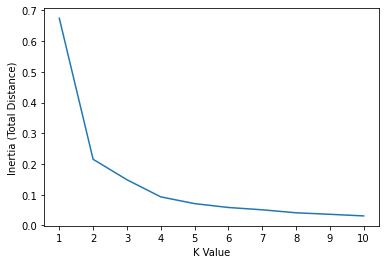

In [20]:
accident_grouped_clustering = accident_grouped.drop('Borough', 1)

def cluster_variance(n):
    variances=[]
    kmeans=[]
    outputs=[]
    K=[i for i in range(1,n+1)]
    for i in range(1,n+1):
        variance=0
        model=KMeans(n_clusters=i,random_state=82,verbose=2).fit(accident_grouped_clustering)
        kmeans.append(model)
        variances.append(model.inertia_)
        
    return variances,K,n

variances,K,n=cluster_variance(10)
plt.plot(K,variances)
plt.ylabel("Inertia (Total Distance)")
plt.xlabel("K Value")
plt.xticks([i for i in range(1,n+1)])
plt.show()

In [21]:
kclusters = 2
accident_grouped_clustering = accident_grouped.drop('Borough', 1)
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(accident_grouped_clustering)
kmeans.labels_[0:10] 

array([0, 0, 0, 0, 0, 1, 1, 0, 0, 0])

In [22]:
borough_accident_vehicles_sorted.insert(0, 'Cluster Labels', kmeans.labels_)
accident_merged = borough_table
accident_merged = accident_merged.join(borough_accident_vehicles_sorted.set_index('Borough'), on='Borough')


In [23]:
accident_merged.head()

,Borough,Local authority,Political control,Area (sq mi),Population (2019 est),Latitude,Longitude,Cluster Labels,1st Most Common Vehicle Type,2nd Most Common Vehicle Type,3rd Most Common Vehicle Type,4th Most Common Vehicle Type,5th Most Common Vehicle Type,6th Most Common Vehicle Type,7th Most Common Vehicle Type,8th Most Common Vehicle Type,9th Most Common Vehicle Type,10th Most Common Vehicle Type
0,Barking and Dagenham,Barking and Dagenham London Borough Council,Labour,13.93,"212,906",51.5607,0.1557,0,09 Car,19 Gds =< 3.5T,01 Pedal Cycle,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,08 Taxi,05 M/C > 500Cc,21 Gds => 7.5T,06 Private Hire - Licensed
1,Barnet,Barnet London Borough Council,Conservative,33.49,"395,896",51.6252,-0.1517,0,09 Car,03 M/C 50-125Cc,19 Gds =< 3.5T,01 Pedal Cycle,05 M/C > 500Cc,90 Other Vehicle,13 London Bus,08 Taxi,06 Private Hire - Licensed,04 M/C 125-500Cc
2,Bexley,Bexley London Borough Council,Conservative,23.38,"248,287",51.4549,0.1505,0,09 Car,19 Gds =< 3.5T,01 Pedal Cycle,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,05 M/C > 500Cc,06 Private Hire - Licensed,21 Gds => 7.5T,08 Taxi
3,Brent,Brent London Borough Council,Labour,16.70,"329,771",51.5588,-0.2817,0,09 Car,03 M/C 50-125Cc,01 Pedal Cycle,19 Gds =< 3.5T,13 London Bus,02 M/C <= 50Cc,05 M/C > 500Cc,08 Taxi,90 Other Vehicle,04 M/C 125-500Cc
4,Bromley,Bromley London Borough Council,Conservative,57.97,"332,336",51.4039,0.0198,0,09 Car,01 Pedal Cycle,19 Gds =< 3.5T,03 M/C 50-125Cc,13 London Bus,05 M/C > 500Cc,02 M/C <= 50Cc,04 M/C 125-500Cc,06 Private Hire - Licensed,90 Other Vehicle


In [28]:
accident_merged

,Borough,Local authority,Political control,Area (sq mi),Population (2019 est),Latitude,Longitude,Cluster Labels,1st Most Common Vehicle Type,2nd Most Common Vehicle Type,3rd Most Common Vehicle Type,4th Most Common Vehicle Type,5th Most Common Vehicle Type,6th Most Common Vehicle Type,7th Most Common Vehicle Type,8th Most Common Vehicle Type,9th Most Common Vehicle Type,10th Most Common Vehicle Type
0,Barking and Dagenham,Barking and Dagenham London Borough Council,Labour,13.93,"212,906",51.5607,0.1557,0,09 Car,19 Gds =< 3.5T,01 Pedal Cycle,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,08 Taxi,05 M/C > 500Cc,21 Gds => 7.5T,06 Private Hire - Licensed
1,Barnet,Barnet London Borough Council,Conservative,33.49,"395,896",51.6252,-0.1517,0,09 Car,03 M/C 50-125Cc,19 Gds =< 3.5T,01 Pedal Cycle,05 M/C > 500Cc,90 Other Vehicle,13 London Bus,08 Taxi,06 Private Hire - Licensed,04 M/C 125-500Cc
2,Bexley,Bexley London Borough Council,Conservative,23.38,"248,287",51.4549,0.1505,0,09 Car,19 Gds =< 3.5T,01 Pedal Cycle,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,05 M/C > 500Cc,06 Private Hire - Licensed,21 Gds => 7.5T,08 Taxi
3,Brent,Brent London Borough Council,Labour,16.70,"329,771",51.5588,-0.2817,0,09 Car,03 M/C 50-125Cc,01 Pedal Cycle,19 Gds =< 3.5T,13 London Bus,02 M/C <= 50Cc,05 M/C > 500Cc,08 Taxi,90 Other Vehicle,04 M/C 125-500Cc
4,Bromley,Bromley London Borough Council,Conservative,57.97,"332,336",51.4039,0.0198,0,09 Car,01 Pedal Cycle,19 Gds =< 3.5T,03 M/C 50-125Cc,13 London Bus,05 M/C > 500Cc,02 M/C <= 50Cc,04 M/C 125-500Cc,06 Private Hire - Licensed,90 Other Vehicle
5,Camden,Camden London Borough Council,Labour,8.40,"270,029",51.5290,-0.1255,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,08 Taxi,13 London Bus,04 M/C 125-500Cc,05 M/C > 500Cc,90 Other Vehicle,06 Private Hire - Licensed
6,Croydon,Croydon London Borough Council,Labour,33.41,"386,710",51.3714,-0.0977,0,09 Car,03 M/C 50-125Cc,01 Pedal Cycle,19 Gds =< 3.5T,90 Other Vehicle,08 Taxi,13 London Bus,02 M/C <= 50Cc,05 M/C > 500Cc,04 M/C 125-500Cc
7,Ealing,Ealing London Borough Council,Labour,21.44,"341,806",51.5130,-0.3089,0,09 Car,03 M/C 50-125Cc,01 Pedal Cycle,19 Gds =< 3.5T,13 London Bus,02 M/C <= 50Cc,05 M/C > 500Cc,08 Taxi,90 Other Vehicle,04 M/C 125-500Cc
8,Enfield,Enfield London Borough Council,Labour,31.74,"333,794",51.6538,-0.0799,0,09 Car,01 Pedal Cycle,19 Gds =< 3.5T,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,08 Taxi,05 M/C > 500Cc,06 Private Hire - Licensed,02 M/C <= 50Cc
9,Greenwich,Greenwich London Borough Council,Labour,18.28,"287,942",51.4892,0.0648,0,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,13 London Bus,05 M/C > 500Cc,90 Other Vehicle,02 M/C <= 50Cc,08 Taxi,06 Private Hire - Licensed


In [24]:
map_clusters = folium.Map(location=[51.509865, -0.118092], zoom_start=12)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(accident_merged['Latitude'], accident_merged['Longitude'], accident_merged['Borough'], accident_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster-1)],
        fill=True,
        fill_color=rainbow[int(cluster-1)],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

In [25]:
accident_merged.loc[accident_merged['Cluster Labels'] == 0, accident_merged.columns[[1] + list(range(5, accident_merged.shape[1]))]]

,Local authority,Latitude,Longitude,Cluster Labels,1st Most Common Vehicle Type,2nd Most Common Vehicle Type,3rd Most Common Vehicle Type,4th Most Common Vehicle Type,5th Most Common Vehicle Type,6th Most Common Vehicle Type,7th Most Common Vehicle Type,8th Most Common Vehicle Type,9th Most Common Vehicle Type,10th Most Common Vehicle Type
0,Barking and Dagenham London Borough Council,51.5607,0.1557,0,09 Car,19 Gds =< 3.5T,01 Pedal Cycle,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,08 Taxi,05 M/C > 500Cc,21 Gds => 7.5T,06 Private Hire - Licensed
1,Barnet London Borough Council,51.6252,-0.1517,0,09 Car,03 M/C 50-125Cc,19 Gds =< 3.5T,01 Pedal Cycle,05 M/C > 500Cc,90 Other Vehicle,13 London Bus,08 Taxi,06 Private Hire - Licensed,04 M/C 125-500Cc
2,Bexley London Borough Council,51.4549,0.1505,0,09 Car,19 Gds =< 3.5T,01 Pedal Cycle,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,05 M/C > 500Cc,06 Private Hire - Licensed,21 Gds => 7.5T,08 Taxi
3,Brent London Borough Council,51.5588,-0.2817,0,09 Car,03 M/C 50-125Cc,01 Pedal Cycle,19 Gds =< 3.5T,13 London Bus,02 M/C <= 50Cc,05 M/C > 500Cc,08 Taxi,90 Other Vehicle,04 M/C 125-500Cc
4,Bromley London Borough Council,51.4039,0.0198,0,09 Car,01 Pedal Cycle,19 Gds =< 3.5T,03 M/C 50-125Cc,13 London Bus,05 M/C > 500Cc,02 M/C <= 50Cc,04 M/C 125-500Cc,06 Private Hire - Licensed,90 Other Vehicle
6,Croydon London Borough Council,51.3714,-0.0977,0,09 Car,03 M/C 50-125Cc,01 Pedal Cycle,19 Gds =< 3.5T,90 Other Vehicle,08 Taxi,13 London Bus,02 M/C <= 50Cc,05 M/C > 500Cc,04 M/C 125-500Cc
7,Ealing London Borough Council,51.5130,-0.3089,0,09 Car,03 M/C 50-125Cc,01 Pedal Cycle,19 Gds =< 3.5T,13 London Bus,02 M/C <= 50Cc,05 M/C > 500Cc,08 Taxi,90 Other Vehicle,04 M/C 125-500Cc
8,Enfield London Borough Council,51.6538,-0.0799,0,09 Car,01 Pedal Cycle,19 Gds =< 3.5T,03 M/C 50-125Cc,13 London Bus,90 Other Vehicle,08 Taxi,05 M/C > 500Cc,06 Private Hire - Licensed,02 M/C <= 50Cc
9,Greenwich London Borough Council,51.4892,0.0648,0,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,13 London Bus,05 M/C > 500Cc,90 Other Vehicle,02 M/C <= 50Cc,08 Taxi,06 Private Hire - Licensed
12,Haringey London Borough Council,51.6000,-0.1119,0,09 Car,03 M/C 50-125Cc,01 Pedal Cycle,19 Gds =< 3.5T,13 London Bus,90 Other Vehicle,08 Taxi,04 M/C 125-500Cc,02 M/C <= 50Cc,05 M/C > 500Cc


In [26]:
accident_merged.loc[accident_merged['Cluster Labels'] == 1, accident_merged.columns[[1] + list(range(5, accident_merged.shape[1]))]]

,Local authority,Latitude,Longitude,Cluster Labels,1st Most Common Vehicle Type,2nd Most Common Vehicle Type,3rd Most Common Vehicle Type,4th Most Common Vehicle Type,5th Most Common Vehicle Type,6th Most Common Vehicle Type,7th Most Common Vehicle Type,8th Most Common Vehicle Type,9th Most Common Vehicle Type,10th Most Common Vehicle Type
5,Camden London Borough Council,51.5290,-0.1255,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,08 Taxi,13 London Bus,04 M/C 125-500Cc,05 M/C > 500Cc,90 Other Vehicle,06 Private Hire - Licensed
10,Hackney London Borough Council,51.5450,-0.0553,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,13 London Bus,90 Other Vehicle,05 M/C > 500Cc,04 M/C 125-500Cc,06 Private Hire - Licensed,11 Bus/Coach
11,Hammersmith and Fulham London Borough Council,51.4927,-0.2339,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,04 M/C 125-500Cc,06 Private Hire - Licensed,08 Taxi,05 M/C > 500Cc,90 Other Vehicle,13 London Bus
17,Islington London Borough Council,51.5416,-0.1022,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,13 London Bus,05 M/C > 500Cc,08 Taxi,06 Private Hire - Licensed,90 Other Vehicle,04 M/C 125-500Cc
18,Kensington and Chelsea London Borough Council,51.5020,-0.1947,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,04 M/C 125-500Cc,13 London Bus,90 Other Vehicle,08 Taxi,06 Private Hire - Licensed,05 M/C > 500Cc
20,Lambeth London Borough Council,51.4607,-0.1163,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,13 London Bus,90 Other Vehicle,04 M/C 125-500Cc,08 Taxi,05 M/C > 500Cc,06 Private Hire - Licensed
25,Richmond upon Thames London Borough Council,51.4479,-0.3260,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,05 M/C > 500Cc,90 Other Vehicle,04 M/C 125-500Cc,06 Private Hire - Licensed,08 Taxi,10 Minibus
26,Southwark London Borough Council,51.5035,-0.0804,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,13 London Bus,90 Other Vehicle,02 M/C <= 50Cc,08 Taxi,04 M/C 125-500Cc,05 M/C > 500Cc
28,Tower Hamlets London Borough Council,51.5099,-0.0059,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,08 Taxi,13 London Bus,05 M/C > 500Cc,04 M/C 125-500Cc,06 Private Hire - Licensed,90 Other Vehicle
30,Wandsworth London Borough Council,51.4567,-0.1910,1,09 Car,01 Pedal Cycle,03 M/C 50-125Cc,19 Gds =< 3.5T,04 M/C 125-500Cc,05 M/C > 500Cc,08 Taxi,13 London Bus,90 Other Vehicle,06 Private Hire - Licensed
